In [37]:
import numpy as np
import sklearn
import pandas as pd
import numpy as np
import random as rnd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import  metrics
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import Perceptron
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from keras.callbacks import LearningRateScheduler
from keras.callbacks import ModelCheckpoint
from keras.callbacks import EarlyStopping
from keras.callbacks import History
import tensorflow as tf
from tensorflow import keras
from keras.optimizers import SGD
from keras.models import Sequential
from keras.layers import Dense
import keras
from keras.models import Sequential
from keras.layers import Dense, Dropout, Activation
from keras.callbacks import History
from keras.wrappers.scikit_learn import KerasClassifier
import pandas as pd
import os
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.base import ClassifierMixin
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import StratifiedKFold
from sklearn.utils import class_weight
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import FeatureUnion
from pandas import DataFrame
import warnings
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OrdinalEncoder
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
import pickle
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import RandomizedSearchCV
from keras.layers import Flatten, BatchNormalization
from sklearn.model_selection import RandomizedSearchCV

print(tf.__version__)
print(keras.__version__)

2.9.0
2.9.0


In [38]:
warnings.simplefilter(action='ignore', category=FutureWarning)

## Import Data

In [39]:
PATH = os.path.join("data", "bank-additional", "bank-additional")

In [40]:
def load_data(filename, path=PATH):
    csv_path = os.path.join(path, filename)
    return pd.read_csv(csv_path,sep=';')

In [41]:
full_data = load_data("bank-additional-full.csv")

We initialize some variables for future use

In [42]:
seed=64

In [43]:
cater=['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'day_of_week', 'poutcome']
cater_no_def=['job', 'marital', 'education', 'housing', 'loan', 'contact', 'month', 'day_of_week', 'poutcome']
numer=['age', 'pdays', 'previous', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed']
all=['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'month', 'day_of_week', 'poutcome','age', 'pdays', 'previous', 'emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed','y']

## Data Preprocessing

We will delete duplicates and data points with 3 or more "unknown" values

In [44]:
class DulicateDeleter(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X, y=None):
        return self
    def transform(self, X,y=None):
        return X.drop_duplicates()

In [45]:
def unknown_number(row):
    bbb=0
    # print(row)
    for sa in row:
        if sa == 'unknown':
            bbb=bbb+1
    return bbb

class UnknownDeleter(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X, y=None):
        return self
    def transform(self, X,y=None):
        return X.drop(X[X.apply(lambda row:unknown_number(row), axis=1)>=3].index)

In [46]:
def null_number(row):
    bbb=0
    # print(row)
    for sa in row:
        if pd.isnull(sa):
            bbb=bbb+1
    return bbb

class NullDeleter(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X, y=None):
        return self
    def transform(self, X,y=None):
        return X.drop(X[X.apply(lambda row:null_number(row), axis=1)>=1].index)

In [47]:
class DataFrameSelector(BaseEstimator, TransformerMixin):
    def __init__(self, attribute_names):
        self.attribute_names = attribute_names
    def fit(self, X, y=None):
        return self
    def transform(self, X,y=None):
        return X[self.attribute_names]

In [48]:
delete_pip = Pipeline([
        ("delete_null", NullDeleter()),
        ("delete_unknown", UnknownDeleter()),
        ("delete_duplicates", DulicateDeleter())
    ])

In [49]:
delete_pip.fit_transform(full_data)

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41183,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes
41184,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41185,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,2,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,no
41186,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94.767,-50.8,1.028,4963.6,yes


In [50]:
print(full_data.shape)
full_data=delete_pip.fit_transform(full_data)
print(full_data.shape)

(41188, 21)
(40848, 21)


As we can see only under 1% od data was removed

In [51]:
label_encoder = LabelEncoder()
full_data['y'] = label_encoder.fit_transform(full_data['y'])

We encode column "y" for ease of use

In [52]:
full_data['y'].value_counts()[1]/full_data['y'].value_counts()[0]

0.12740119231618457

In [53]:
full_data=delete_pip.fit_transform(full_data)

_, cut_data = train_test_split(full_data, test_size=0.2, random_state=seed)
# _, cut_data = train_test_split(full_data, test_size=0.05, stratify=full_data['y'], random_state=seed)
# cut_data=full_data

cut_data['y'].value_counts()[1]/cut_data['y'].value_counts()[0]

0.1242603550295858

We randomly drop 80% of rows to spead up model training.

In [54]:
X = cut_data.drop(['y'], axis=1)
y = cut_data['y'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=seed)
print("X_train.shape: {} y_train.shape: {}".format(X_train.shape, y_train.shape))
print("X_test.shape: {} y_test.shape: {}".format(X_test.shape, y_test.shape))


X_train.shape: (6536, 20) y_train.shape: (6536,)
X_test.shape: (1634, 20) y_test.shape: (1634,)


We divide the data into train and test at 4:1 ratio

We define pipelines for preprocessing of data

In [55]:
class MostFrequentImputer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        self.most_frequent_ = pd.Series([X[c].value_counts().index[0] for c in X], index=X.columns)
        return self
    def transform(self, X, y=None):
        return X.fillna(self.most_frequent_)

For numerical variables we replace NaN values with median od this column, then we scale the data

In [56]:
num_pip = Pipeline([
        ("select_cat", DataFrameSelector(numer)),
        ("imputer_mean", SimpleImputer(missing_values=np.nan, strategy="median")),
        ("scaler", StandardScaler())
    ])

In [57]:
num_pip.fit_transform(X_train)

array([[ 0.56789061,  0.1926925 , -0.34689467, ..., -0.31127092,
         0.23304915,  0.39708789],
       [-0.10089012,  0.1926925 , -0.34689467, ..., -0.4640939 ,
         0.77442608,  0.84981225],
       [ 1.33221145,  0.1926925 , -0.34689467, ..., -1.22820876,
        -1.35648885, -0.95828195],
       ...,
       [-1.15183126,  0.1926925 , -0.34689467, ..., -0.26760722,
         0.77384953,  0.84981225],
       [-0.57859064,  0.1926925 , -0.34689467, ..., -1.22820876,
        -1.31613062, -0.95828195],
       [-1.24737137,  0.1926925 , -0.34689467, ..., -1.22820876,
        -1.35533576, -0.95828195]])

For categrical variables we replace "unknown" and NaN values with most frequent other answer, then we encode data points with one hot encoder

In [58]:
cat_pip = Pipeline([
        ("select_cat", DataFrameSelector(cater_no_def)),
        ("imputer_freq_unk", SimpleImputer(missing_values="unknown", strategy="most_frequent")),
        ("imputer_freq_nan", SimpleImputer(missing_values=np.nan, strategy="most_frequent")),
        ("cat_encoder", OneHotEncoder(sparse=False, handle_unknown = 'ignore'))
    ])

In [59]:
cat_pip.fit_transform(X_train)

array([[0., 0., 0., ..., 0., 1., 0.],
       [0., 1., 0., ..., 0., 1., 0.],
       [1., 0., 0., ..., 0., 1., 0.],
       ...,
       [0., 1., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [1., 0., 0., ..., 0., 1., 0.]])

Because in column "default" answer "unknown is notably different and sizable we do not remove that value for this column, instead leaving it and encoding it as any other value

In [60]:
default_pip = Pipeline([
        ("select_default", DataFrameSelector(['default'])),
        ("imputer_freq", SimpleImputer(missing_values=np.nan, strategy="most_frequent")),
        ("cat_encoder", OneHotEncoder(sparse=False, handle_unknown = 'ignore'))
    ])

In [61]:
default_pip.fit_transform(X_train)

array([[1., 0., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       ...,
       [0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.]])

In [62]:
preprocess_pipeline = FeatureUnion(transformer_list=[
        ("num_pip", num_pip),
        ("cat_pip", cat_pip),
        ("def_pip", default_pip)
    ])

In [63]:
DataFrame(preprocess_pipeline.fit_transform(X_train))

,0,1,2,3,4,5,6,7,8,9,...,46,47,48,49,50,51,52,53,54,55
0,0.567891,0.192692,-0.346895,-0.113349,-0.644430,-0.311271,0.233049,0.397088,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,-0.100890,0.192692,-0.346895,0.840694,0.590580,-0.464094,0.774426,0.849812,0.0,1.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2,1.332211,0.192692,-0.346895,-1.194597,-1.172491,-1.228209,-1.356489,-0.958282,1.0,0.0,...,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
3,1.523292,0.192692,1.666696,-0.113349,-0.644430,-0.311271,0.233049,0.397088,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
4,-0.960751,0.192692,-0.346895,-2.212242,-1.967164,2.985339,-1.668977,-2.102007,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6531,0.854511,0.192692,-0.346895,0.649886,0.721305,0.911313,0.715042,0.329810,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
6532,-0.578591,0.192692,-0.346895,-0.113349,-0.644430,-0.311271,0.309153,0.397088,0.0,1.0,...,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
6533,-1.151831,0.192692,-0.346895,0.840694,1.531458,-0.267607,0.773850,0.849812,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
6534,-0.578591,0.192692,-0.346895,-1.194597,-1.172491,-1.228209,-1.316131,-0.958282,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0


We define variables useful in training models

In [64]:
labels = {'model_name': [], 'model': [], 'model_history': [], 'model_params': [], 'proba': [], 'precision_score': [], 'recall_score': [], 'f1_score': [], 'accuracy_score': [], 'balanced_accuracy_score': []}

my_models = pd.DataFrame(labels)
added_models=0

To account for imbalance in dataset we calculate weights of classes that will make models more sensitive to underpopulated positive class

In [65]:
class_weights = class_weight.compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
class_weights_dict = dict(enumerate(class_weights))
print(class_weights_dict)
class_weights_ratio=class_weights_dict[1]/class_weights_dict[0]
print(class_weights_ratio)

{0: 0.5634482758620689, 1: 4.440217391304348}
7.880434782608696


As we can see ratio between weight of negative class and positive is 7.8

In [66]:
def archive_model(name, model, params=None, history=None, proba=False):
    y_test_pred=model.predict(X_test)
    to_append = {
        'model_name': name,
        'model': model,
        'model_history': history,
        'model_params': params,
        'proba': proba,
        'precision_score': metrics.precision_score(y_test, y_test_pred),
        'recall_score': metrics.recall_score(y_test, y_test_pred),
        'f1_score': metrics.f1_score(y_test, y_test_pred),
        'accuracy_score': metrics.accuracy_score(y_test, y_test_pred),
        'balanced_accuracy_score': metrics.balanced_accuracy_score(y_test, y_test_pred)}
    return to_append

In [67]:
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=seed)

For purposes of comparison I declare "dumb classifier" that returns false for every datapoint

In [68]:
class DumbClassifier(BaseEstimator, ClassifierMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        pass

    def predict(self, X, y=None):
        return np.zeros((len(X)))

    def predict_proba(self, X, y=None):
        pass

## Model Trainig

### Shalow Models

We preform GridSearch on every model, finding most optimal parameters, then we save the best model to list, for future comparison
We train all models with class_weights parameter that makes them value underrepresented positive class data points a lot more, but por purposes of comparison we also train couple models without this parameter.

In [69]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', DumbClassifier())])

param_grid = {}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1)

grid.fit(X_train, y_train)

print(grid.best_params_)

model_name="{}: Dumb Classifier - {}".format(added_models, None)
added_models=added_models+1
my_models = my_models.append(
    archive_model(model_name,grid.best_estimator_, proba=False, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
{}


C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [70]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', LogisticRegression(class_weight=None, solver='liblinear' , verbose=1))])

param_grid = {
            'classifier__C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
            'classifier__penalty': ['l1', 'l2']
}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: Logistic Regression - {}".format(added_models, None)
added_models=added_models+1
my_models = my_models.append(
    archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 14 candidates, totalling 70 fits
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]{'classifier__C': 10, 'classifier__penalty': 'l1'}


In [71]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', LogisticRegression(class_weight='balanced', solver='liblinear' , verbose=1))])

param_grid = {
            'classifier__C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
            'classifier__penalty': ['l1', 'l2']
}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: Logistic Regression - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
    archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 14 candidates, totalling 70 fits
[LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear][LibLinear]{'classifier__C': 1, 'classifier__penalty': 'l1'}


In [72]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', SVC(kernel="rbf", class_weight=None, probability=False, verbose=1))])

param_grid = {
            'classifier__gamma': [10**(-4),10**(-3), 10**(-2), 10**(-1), 1, 10,100],
            'classifier__C': [ 10**(-2), 10**(-1), 1, 10**(1), 10**(2)]
}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: SVC rbf - {}".format(added_models, None)
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=False, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 35 candidates, totalling 175 fits
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][L

In [73]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', SVC(kernel="rbf", class_weight='balanced', probability=False, verbose=1))])

param_grid = {
            'classifier__gamma': [10**(-4),10**(-3), 10**(-2), 10**(-1), 1,],
            'classifier__C': [10**(-1), 1, 10**(1), 10**(2), 10**(3)]
}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)


model_name="{}: SVC rbf - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=False, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 25 candidates, totalling 125 fits
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][L

In [74]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', SVC(kernel='linear', class_weight='balanced', probability=False, verbose=1))])

param_grid = {
            'classifier__C': [10**(-2), 10**(-1), 1, 10**(1), 10**(2)]
}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)


model_name="{}: SVC linear - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=False ,params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 5 candidates, totalling 25 fits
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM]{'classifier__C': 1}


In [75]:

pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', SVC(kernel='poly', class_weight='balanced', probability=False, verbose=1))])

param_grid = {
            'classifier__degree': [2, 3, 4],
            'classifier__C': [ 10**(-1), 1, 10**(1)],
            'classifier__coef0': [0, 1, 2]
}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: SVC poly - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=False, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 27 candidates, totalling 135 fits
[LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][LibSVM][L

In [76]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', GradientBoostingClassifier( verbose=1))])

param_grid = {
    "classifier__loss":["deviance", "exponential"],
    "classifier__learning_rate": [0.01, 0.1, 1],
    "classifier__max_features":["log2","sqrt"],
    "classifier__criterion": ["friedman_mse",  "squared_error"],
    "classifier__subsample":[ 0.5, 0.8, 1],
    "classifier__n_estimators":[1, 5, 10]
    }

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1)

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: Gradient Boosting - {}".format(added_models, None)
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 216 candidates, totalling 1080 fits
      Iter       Train Loss      OOB Improve   Remaining Time 
         1           0.6923           0.0013            0.00s
      Iter       Train Loss      OOB Improve   Remaining Time 
         1           0.6713           0.0017            0.00s
      Iter       Train Loss      OOB Improve   Remaining Time 
         1           0.7129           0.0032            0.00s
      Iter       Train Loss      OOB Improve   Remaining Time 
         1           0.7003           0.0010            0.00s
      Iter       Train Loss      OOB Improve   Remaining Time 
         1           0.7184           0.0021            0.00s
      Iter       Train Loss      OOB Improve   Remaining Time 
         1           0.6882           0.0023            0.00s
      Iter       Train Loss      OOB Improve   Remaining Time 
         1           0.6965           0.0010            0.00s
      Iter       Train Loss      OOB Improve   Remaining Time

In [77]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', XGBClassifier(scale_pos_weight = class_weights_ratio, verbosity = 2, learning_rate=0.02, n_estimators=600, objective='binary:logistic', nthread=1))])

param_grid = {
        'classifier__gamma': [0, 0.5, 1, 5],
        'classifier__subsample': [0.5, 1.0],
        'classifier__colsample_bytree': [0.5, 0.8, 1.0],
        'classifier__max_depth': [4, 6, 8]
        }

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: XGBoost - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 72 candidates, totalling 360 fits
[17:07:09] INFO: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/tree/updater_prune.cc:101: tree pruning end, 22 extra nodes, 0 pruned nodes, max_depth=4
[17:07:09] INFO: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/tree/updater_prune.cc:101: tree pruning end, 24 extra nodes, 0 pruned nodes, max_depth=4
[17:07:09] INFO: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/tree/updater_prune.cc:101: tree pruning end, 28 extra nodes, 0 pruned nodes, max_depth=4
[17:07:09] INFO: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/tree/updater_prune.cc:101: tree pruning end, 30 extra nodes, 0 pruned nodes, max_depth=4
[17:07:09] INFO: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/tree/updater_prune.cc:101: tree pruning end, 20 extra nodes, 0 pruned nodes, max_depth=4
[17:07:09] INFO: C:/Users/Administrator/workspace/xgboost-win64_release_1.6.0/src/t

In [78]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', DecisionTreeClassifier(class_weight='balanced'))])

param_grid = {
    'classifier__max_leaf_nodes': [None, 10, 50],
    'classifier__max_features': ['sqrt', 'log2'],
    'classifier__min_samples_split': [ 2, 3, 4, 5],
    'classifier__criterion': ['gini', 'entropy'],
    'classifier__splitter': ['best', 'random']
}

grid = GridSearchCV(pipe, param_grid, cv=kfold, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: Decision Tree - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 96 candidates, totalling 480 fits
{'classifier__criterion': 'entropy', 'classifier__max_features': 'sqrt', 'classifier__max_leaf_nodes': 10, 'classifier__min_samples_split': 3, 'classifier__splitter': 'best'}


In [79]:
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', RandomForestClassifier(class_weight='balanced',verbose=1))])

param_grid = {
            'classifier__max_depth': [ 10, 50, 100],
            'classifier__max_features': ['sqrt', 'log2'],
            'classifier__bootstrap': [True, False],
            'classifier__n_estimators': [100, 500, 1000],
}

grid = GridSearchCV(pipe, param_grid, cv = kfold, n_jobs = 2, verbose=1, scoring='balanced_accuracy')

grid.fit(X_train, y_train)
print(grid.best_params_)

model_name="{}: Random Forest - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

Fitting 5 folds for each of 36 candidates, totalling 180 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:    3.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


{'classifier__bootstrap': False, 'classifier__max_depth': 10, 'classifier__max_features': 'log2', 'classifier__n_estimators': 500}


[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:    0.1s finished


### Neural Networks

First we train couple simple Neural networks and record the results, then we preform very limited RandomizedSearch for multiple optimizer.
As with shallow models, here also train most neural networks with class weights and couple without

In [80]:
input_shape=preprocess_pipeline.transform(X_train).shape[1]

In [81]:
def neural_network_1():
    model = Sequential()

    model.add(Dense(32, input_dim=input_shape, activation='sigmoid'))
    model.add(Dense(16, activation='sigmoid'))
    model.add(Dense(8, activation='sigmoid'))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_1, epochs=100, batch_size=64, validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])
history = History()

trained_model = pipe.fit(X_train, y_train, classifier__callbacks=[history])

model_name="{}: NN 1 - {}".format(added_models, None)
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,trained_model, proba=True, history=history), ignore_index = True)

C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\4108101540.py:12: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_1, epochs=100, batch_size=64, validation_split=0.2)


Epoch 1/100
82/82 [==============================] - 2s 6ms/step - loss: 0.4096 - accuracy: 0.8889 - val_loss: 0.3753 - val_accuracy: 0.8815
Epoch 2/100
82/82 [==============================] - 0s 2ms/step - loss: 0.3530 - accuracy: 0.8889 - val_loss: 0.3596 - val_accuracy: 0.8815
Epoch 3/100
82/82 [==============================] - 0s 2ms/step - loss: 0.3416 - accuracy: 0.8889 - val_loss: 0.3517 - val_accuracy: 0.8815
Epoch 4/100
82/82 [==============================] - 0s 2ms/step - loss: 0.3305 - accuracy: 0.8889 - val_loss: 0.3396 - val_accuracy: 0.8815
Epoch 5/100
82/82 [==============================] - 0s 2ms/step - loss: 0.3163 - accuracy: 0.8889 - val_loss: 0.3272 - val_accuracy: 0.8815
Epoch 6/100
82/82 [==============================] - 0s 2ms/step - loss: 0.3030 - accuracy: 0.8889 - val_loss: 0.3170 - val_accuracy: 0.8815
Epoch 7/100
82/82 [==============================] - 0s 2ms/step - loss: 0.2923 - accuracy: 0.8889 - val_loss: 0.3097 - val_accuracy: 0.8815
Epoch 8/100
8

In [82]:
def neural_network_1():
    model = Sequential()

    model.add(Dense(32, input_dim=input_shape, activation='sigmoid'))
    model.add(Dense(16, activation='sigmoid'))
    model.add(Dense(8, activation='sigmoid'))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy', optimizer='Adam', metrics=['accuracy'])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_1, epochs=100, batch_size=64, validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])
history = History()

trained_model = pipe.fit(X_train, y_train, classifier__class_weight=class_weights_dict, classifier__callbacks=[history])

model_name="{}: NN 1 - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,trained_model, proba=True, history=history), ignore_index = True)

Epoch 1/100


C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\2987315747.py:12: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_1, epochs=100, batch_size=64, validation_split=0.2)


82/82 [==============================] - 1s 4ms/step - loss: 0.7042 - accuracy: 0.2408 - val_loss: 0.6971 - val_accuracy: 0.5902
Epoch 2/100
82/82 [==============================] - 0s 3ms/step - loss: 0.6639 - accuracy: 0.7083 - val_loss: 0.6513 - val_accuracy: 0.6957
Epoch 3/100
82/82 [==============================] - 0s 2ms/step - loss: 0.6246 - accuracy: 0.7370 - val_loss: 0.6312 - val_accuracy: 0.6972
Epoch 4/100
82/82 [==============================] - 0s 2ms/step - loss: 0.5873 - accuracy: 0.7330 - val_loss: 0.5625 - val_accuracy: 0.7362
Epoch 5/100
82/82 [==============================] - 0s 2ms/step - loss: 0.5634 - accuracy: 0.7863 - val_loss: 0.5382 - val_accuracy: 0.7791
Epoch 6/100
82/82 [==============================] - 0s 2ms/step - loss: 0.5479 - accuracy: 0.8150 - val_loss: 0.5913 - val_accuracy: 0.7469
Epoch 7/100
82/82 [==============================] - 0s 3ms/step - loss: 0.5422 - accuracy: 0.8143 - val_loss: 0.5515 - val_accuracy: 0.7829
Epoch 8/100
82/82 [======

In [83]:
def neural_network_2():
    model = Sequential()

    model.add(Dense(500, input_dim=input_shape, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(200, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(100, activation='relu'))
    model.add(Dropout(0.3))
    model.add(Dense(1, activation='sigmoid'))

    model.compile(loss='binary_crossentropy', optimizer='SGD', metrics=['accuracy'])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_2, epochs=100, batch_size=64,  validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])
history = History()

trained_model = pipe.fit(X_train, y_train, classifier__class_weight=class_weights_dict, classifier__callbacks=[history])

model_name="{}: NN 2 - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,trained_model, proba=True, history=history), ignore_index = True)

C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\2242687435.py:15: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_2, epochs=100, batch_size=64,  validation_split=0.2)


Epoch 1/100
82/82 [==============================] - 1s 8ms/step - loss: 0.6624 - accuracy: 0.4246 - val_loss: 0.6305 - val_accuracy: 0.7401
Epoch 2/100
82/82 [==============================] - 0s 5ms/step - loss: 0.6154 - accuracy: 0.6773 - val_loss: 0.5910 - val_accuracy: 0.7187
Epoch 3/100
82/82 [==============================] - 0s 5ms/step - loss: 0.5909 - accuracy: 0.7154 - val_loss: 0.5545 - val_accuracy: 0.7278
Epoch 4/100
82/82 [==============================] - 0s 5ms/step - loss: 0.5708 - accuracy: 0.7406 - val_loss: 0.5373 - val_accuracy: 0.7286
Epoch 5/100
82/82 [==============================] - 0s 6ms/step - loss: 0.5707 - accuracy: 0.7420 - val_loss: 0.5438 - val_accuracy: 0.7202
Epoch 6/100
82/82 [==============================] - 0s 5ms/step - loss: 0.5640 - accuracy: 0.7456 - val_loss: 0.5318 - val_accuracy: 0.7462
Epoch 7/100
82/82 [==============================] - 0s 5ms/step - loss: 0.5693 - accuracy: 0.7557 - val_loss: 0.5321 - val_accuracy: 0.7622
Epoch 8/100
8

In [84]:
def neural_network_3():
    model = Sequential()

    model.add(Flatten(input_shape=[input_shape]))
    model.add(BatchNormalization())
    model.add(Activation("relu"))
    model.add(Dropout(0.3))

    model.add(Dense(1000))
    model.add(BatchNormalization())
    model.add(Activation("relu"))
    model.add(Dropout(0.3))

    model.add(Dense(500))
    model.add(BatchNormalization())
    model.add(Activation("relu"))
    model.add(Dropout(0.3))

    model.add(Dense(200))
    model.add(BatchNormalization())
    model.add(Activation("relu"))
    model.add(Dropout(0.3))

    model.add(Dense(1,activation="sigmoid"))

    model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_3, epochs=1000, batch_size=32,  validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])

history = History()
early_stopping = EarlyStopping(monitor='val_loss', patience=100, mode='min', verbose=1)
trained_model = pipe.fit(X_train, y_train, classifier__class_weight=class_weights_dict, classifier__callbacks=[history,early_stopping])

model_name="{}: NN 3 - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,trained_model, proba=True, history=history), ignore_index = True)

C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\3540544439.py:29: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(neural_network_3, epochs=1000, batch_size=32,  validation_split=0.2)


Epoch 1/1000
164/164 [==============================] - 4s 11ms/step - loss: 0.6946 - accuracy: 0.6283 - val_loss: 0.4996 - val_accuracy: 0.8219
Epoch 2/1000
164/164 [==============================] - 2s 10ms/step - loss: 0.6401 - accuracy: 0.6880 - val_loss: 0.5668 - val_accuracy: 0.7454
Epoch 3/1000
164/164 [==============================] - 2s 10ms/step - loss: 0.6047 - accuracy: 0.6897 - val_loss: 0.4822 - val_accuracy: 0.8219
Epoch 4/1000
164/164 [==============================] - 2s 9ms/step - loss: 0.6074 - accuracy: 0.7102 - val_loss: 0.4803 - val_accuracy: 0.8226
Epoch 5/1000
164/164 [==============================] - 2s 9ms/step - loss: 0.5777 - accuracy: 0.7345 - val_loss: 0.4916 - val_accuracy: 0.8081
Epoch 6/1000
164/164 [==============================] - 2s 10ms/step - loss: 0.5718 - accuracy: 0.7441 - val_loss: 0.5328 - val_accuracy: 0.7989
Epoch 7/1000
164/164 [==============================] - 2s 9ms/step - loss: 0.5757 - accuracy: 0.7525 - val_loss: 0.5316 - val_accur

In [87]:
def build_model_SGD(lyrs=[16,8], activation='relu', dropout_rate=0.3, lr=0.01, mom=0.0, nest=False):
    model = Sequential()
    model.add(keras.layers.InputLayer(input_shape=[input_shape]))
    model.add(BatchNormalization())
    model.add(Activation(activation))
    model.add(Dropout(dropout_rate))

    for i in range(0,len(lyrs)):
        model.add(Dense(lyrs[i]))
        model.add(BatchNormalization())
        model.add(Activation(activation))
        model.add(Dropout(dropout_rate))

    model.add(keras.layers.Dense(1, activation='sigmoid'))
    optimizer = keras.optimizers.SGD(learning_rate=lr, momentum=mom, nesterov=nest)
    model.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(build_model_SGD, epochs=100, batch_size=32,  validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])
history = History()

param_distribs = {
    "classifier__lyrs": [[16,8], [64,32,16], [200,100,50]],
    "classifier__activation": ['relu', 'elu', 'sigmoid', 'tanh'],
    "classifier__lr": [0.001, 0.01, 0.1],
    "classifier__dropout_rate": [0.2, 0.3, 0.4],
    "classifier__mom": [0.0, 0.5, 0.9],
    "classifier__nest": [True, False],
    "classifier__batch_size": [16, 32, 64]
}

early_stopping = EarlyStopping(monitor='val_loss', patience=30, mode='min', verbose=1)
grid = RandomizedSearchCV(pipe, param_distribs, n_iter=15, cv=kfold, verbose=1, scoring='balanced_accuracy')
grid.fit(X_train, y_train, classifier__callbacks=[early_stopping])

print(grid.best_params_)

model_name="{}: NN SGD RS - {}".format(added_models, None)
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\3425993823.py:19: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(build_model_SGD, epochs=100, batch_size=32,  validation_split=0.2)


Fitting 5 folds for each of 15 candidates, totalling 75 fits
Epoch 1/100
Epoch 1/100
262/262 [==============================] - 3s 5ms/step - loss: 0.5201 - accuracy: 0.7770 - val_loss: 0.4151 - val_accuracy: 0.8901
Epoch 2/100
262/262 [==============================] - 1s 5ms/step - loss: 0.4450 - accuracy: 0.8403 - val_loss: 0.3744 - val_accuracy: 0.8901
Epoch 3/100
262/262 [==============================] - 1s 5ms/step - loss: 0.4133 - accuracy: 0.8707 - val_loss: 0.3576 - val_accuracy: 0.8901
Epoch 4/100
262/262 [==============================] - 1s 5ms/step - loss: 0.3990 - accuracy: 0.8774 - val_loss: 0.3512 - val_accuracy: 0.8901
Epoch 5/100
262/262 [==============================] - 1s 4ms/step - loss: 0.3948 - accuracy: 0.8826 - val_loss: 0.3483 - val_accuracy: 0.8901
Epoch 6/100
262/262 [==============================] - 1s 4ms/step - loss: 0.3896 - accuracy: 0.8838 - val_loss: 0.3469 - val_accuracy: 0.8901
Epoch 7/100
262/262 [==============================] - 1s 4ms/step - 

C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
30 fits failed out of a total of 75.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\sit

Epoch 1/100
327/327 [==============================] - 3s 4ms/step - loss: 0.4336 - accuracy: 0.8648 - val_loss: 0.3810 - val_accuracy: 0.8815
Epoch 2/100
327/327 [==============================] - 1s 3ms/step - loss: 0.4030 - accuracy: 0.8808 - val_loss: 0.3690 - val_accuracy: 0.8815
Epoch 3/100
327/327 [==============================] - 1s 3ms/step - loss: 0.3837 - accuracy: 0.8864 - val_loss: 0.3646 - val_accuracy: 0.8815
Epoch 4/100
327/327 [==============================] - 1s 3ms/step - loss: 0.3780 - accuracy: 0.8871 - val_loss: 0.3636 - val_accuracy: 0.8815
Epoch 5/100
327/327 [==============================] - 1s 3ms/step - loss: 0.3759 - accuracy: 0.8883 - val_loss: 0.3632 - val_accuracy: 0.8815
Epoch 6/100
327/327 [==============================] - 1s 3ms/step - loss: 0.3777 - accuracy: 0.8881 - val_loss: 0.3633 - val_accuracy: 0.8815
Epoch 7/100
327/327 [==============================] - 1s 3ms/step - loss: 0.3706 - accuracy: 0.8889 - val_loss: 0.3636 - val_accuracy: 0.8815

C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [88]:
def build_model_SGD(lyrs=[16,8], activation='relu', dropout_rate=0.3, lr=0.01, mom=0.0, nest=False):
    model = Sequential()
    model.add(keras.layers.InputLayer(input_shape=[input_shape]))
    model.add(BatchNormalization())
    model.add(Activation(activation))
    model.add(Dropout(dropout_rate))

    for i in range(0,len(lyrs)):
        model.add(Dense(lyrs[i]))
        model.add(BatchNormalization())
        model.add(Activation(activation))
        model.add(Dropout(dropout_rate))

    model.add(keras.layers.Dense(1, activation='sigmoid'))
    optimizer = keras.optimizers.SGD(learning_rate=lr, momentum=mom, nesterov=nest)
    model.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(build_model_SGD, epochs=100, batch_size=32,  validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])
history = History()

param_distribs = {
    "classifier__lyrs": [[16,8], [64,32,16], [200,100,50]],
    "classifier__activation": ['relu', 'elu', 'sigmoid', 'tanh'],
    "classifier__lr": [0.001, 0.01, 0.1],
    "classifier__dropout_rate": [0.2, 0.3, 0.4],
    "classifier__mom": [0.0, 0.5, 0.9],
    "classifier__nest": [True, False],
    "classifier__batch_size": [16, 32, 64]
}
#     "classifier__optimizer": ['Adam', 'SGD', 'Adagrad']
early_stopping = EarlyStopping(monitor='val_loss', patience=30, mode='min', verbose=1)
grid = RandomizedSearchCV(pipe, param_distribs, n_iter=15, cv=kfold, verbose=1, scoring='balanced_accuracy')
grid.fit(X_train, y_train,classifier__class_weight=class_weights_dict, classifier__callbacks=[early_stopping])

print(grid.best_params_)

model_name="{}: NN SGD RS - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\3624652767.py:19: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(build_model_SGD, epochs=100, batch_size=32,  validation_split=0.2)


Fitting 5 folds for each of 15 candidates, totalling 75 fits
Epoch 1/100
Epoch 1/100
66/66 [==============================] - 2s 7ms/step - loss: 0.6837 - accuracy: 0.5659 - val_loss: 0.6752 - val_accuracy: 0.6826
Epoch 2/100
66/66 [==============================] - 0s 3ms/step - loss: 0.6478 - accuracy: 0.6376 - val_loss: 0.5248 - val_accuracy: 0.7055
Epoch 3/100
66/66 [==============================] - 0s 5ms/step - loss: 0.6255 - accuracy: 0.6627 - val_loss: 0.6741 - val_accuracy: 0.6778
Epoch 4/100
66/66 [==============================] - 0s 4ms/step - loss: 0.6153 - accuracy: 0.6586 - val_loss: 0.4690 - val_accuracy: 0.7725
Epoch 5/100
66/66 [==============================] - 0s 3ms/step - loss: 0.6145 - accuracy: 0.6761 - val_loss: 0.5762 - val_accuracy: 0.6960
Epoch 6/100
66/66 [==============================] - 0s 3ms/step - loss: 0.6112 - accuracy: 0.6930 - val_loss: 0.6942 - val_accuracy: 0.6386
Epoch 7/100
66/66 [==============================] - 0s 3ms/step - loss: 0.5987 -

C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
30 fits failed out of a total of 75.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\sit

Epoch 1/100
82/82 [==============================] - 4s 10ms/step - loss: 0.6702 - accuracy: 0.6027 - val_loss: 0.6025 - val_accuracy: 0.7141
Epoch 2/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6412 - accuracy: 0.6297 - val_loss: 0.4361 - val_accuracy: 0.8540
Epoch 3/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6187 - accuracy: 0.6551 - val_loss: 0.4945 - val_accuracy: 0.7798
Epoch 4/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6179 - accuracy: 0.6612 - val_loss: 0.5780 - val_accuracy: 0.7217
Epoch 5/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6027 - accuracy: 0.6792 - val_loss: 0.5219 - val_accuracy: 0.7477
Epoch 6/100
82/82 [==============================] - 0s 4ms/step - loss: 0.5975 - accuracy: 0.7119 - val_loss: 0.5589 - val_accuracy: 0.7645
Epoch 7/100
82/82 [==============================] - 0s 4ms/step - loss: 0.5985 - accuracy: 0.7041 - val_loss: 0.5289 - val_accuracy: 0.7997
Epoch 8/100


In [89]:
def build_model_Adam(lyrs=[16,8], activation='relu', dropout_rate=0.3, lr=0.01):
    model = Sequential()
    model.add(keras.layers.InputLayer(input_shape=[input_shape]))
    model.add(BatchNormalization())
    model.add(Activation(activation))
    model.add(Dropout(dropout_rate))

    for i in range(0,len(lyrs)):
        model.add(Dense(lyrs[i]))
        model.add(BatchNormalization())
        model.add(Activation(activation))
        model.add(Dropout(dropout_rate))

    model.add(keras.layers.Dense(1, activation='sigmoid'))
    optimizer = keras.optimizers.Adam(learning_rate=lr)
    model.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(build_model_Adam, epochs=100, batch_size=32,  validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])
history = History()

param_distribs = {
    "classifier__lyrs": [[16,8], [64,32,16], [200,100,50]],
    "classifier__activation": ['relu', 'sigmoid', 'tanh'],
    "classifier__lr": [0.001, 0.01, 0.1],
    "classifier__dropout_rate": [0.2, 0.3, 0.4],
    "classifier__batch_size": [16, 32, 64]
}

early_stopping = EarlyStopping(monitor='val_loss', patience=30, mode='min', verbose=1)
grid = RandomizedSearchCV(pipe, param_distribs, n_iter=15, cv=kfold, verbose=1, scoring='balanced_accuracy')
grid.fit(X_train, y_train,classifier__class_weight=class_weights_dict, classifier__callbacks=[early_stopping])

print(grid.best_params_)

model_name="{}: NN Adam RS - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\4074773917.py:19: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(build_model_Adam, epochs=100, batch_size=32,  validation_split=0.2)


Fitting 5 folds for each of 15 candidates, totalling 75 fits
Epoch 1/100
Epoch 1/100
66/66 [==============================] - 3s 10ms/step - loss: 0.7102 - accuracy: 0.5635 - val_loss: 0.5526 - val_accuracy: 0.8901
Epoch 2/100
66/66 [==============================] - 0s 5ms/step - loss: 0.6626 - accuracy: 0.5781 - val_loss: 0.4922 - val_accuracy: 0.8681
Epoch 3/100
66/66 [==============================] - 1s 8ms/step - loss: 0.6455 - accuracy: 0.6180 - val_loss: 0.4635 - val_accuracy: 0.8174
Epoch 4/100
66/66 [==============================] - 0s 5ms/step - loss: 0.6425 - accuracy: 0.6390 - val_loss: 0.4832 - val_accuracy: 0.7973
Epoch 5/100
66/66 [==============================] - 0s 4ms/step - loss: 0.6374 - accuracy: 0.6261 - val_loss: 0.5038 - val_accuracy: 0.7572
Epoch 6/100
66/66 [==============================] - 1s 9ms/step - loss: 0.6336 - accuracy: 0.6187 - val_loss: 0.4993 - val_accuracy: 0.7400
Epoch 7/100
66/66 [==============================] - 0s 5ms/step - loss: 0.6290 

C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
30 fits failed out of a total of 75.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\sit

Epoch 1/100
82/82 [==============================] - 3s 10ms/step - loss: 0.7098 - accuracy: 0.5509 - val_loss: 0.6563 - val_accuracy: 0.7041
Epoch 2/100
82/82 [==============================] - 1s 10ms/step - loss: 0.6606 - accuracy: 0.5926 - val_loss: 0.5627 - val_accuracy: 0.7164
Epoch 3/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6496 - accuracy: 0.5870 - val_loss: 0.6010 - val_accuracy: 0.7026
Epoch 4/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6300 - accuracy: 0.6280 - val_loss: 0.5766 - val_accuracy: 0.7087
Epoch 5/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6249 - accuracy: 0.6591 - val_loss: 0.6030 - val_accuracy: 0.7102
Epoch 6/100
82/82 [==============================] - 1s 8ms/step - loss: 0.6302 - accuracy: 0.6551 - val_loss: 0.5692 - val_accuracy: 0.7278
Epoch 7/100
82/82 [==============================] - 0s 4ms/step - loss: 0.6132 - accuracy: 0.6727 - val_loss: 0.5160 - val_accuracy: 0.7806
Epoch 8/100

In [90]:
def build_model_Adagrad(lyrs=[16,8], activation='relu', dropout_rate=0.3, lr=0.01):
    model = Sequential()
    model.add(keras.layers.InputLayer(input_shape=[input_shape]))
    model.add(BatchNormalization())
    model.add(Activation(activation))
    model.add(Dropout(dropout_rate))

    for i in range(0,len(lyrs)):
        model.add(Dense(lyrs[i]))
        model.add(BatchNormalization())
        model.add(Activation(activation))
        model.add(Dropout(dropout_rate))

    model.add(keras.layers.Dense(1, activation='sigmoid'))
    optimizer = keras.optimizers.Adagrad(learning_rate=lr)
    model.compile(loss="binary_crossentropy", optimizer=optimizer, metrics=["accuracy"])
    return model

model = keras.wrappers.scikit_learn.KerasClassifier(build_model_Adagrad, epochs=100, batch_size=32,  validation_split=0.2)
pipe = Pipeline([
    ('preprocessing', preprocess_pipeline),
    ('classifier', model)])
history = History()

param_distribs = {
    "classifier__lyrs": [[16,8], [64,32,16], [200,100,50]],
    "classifier__activation": ['relu', 'sigmoid', 'tanh'],
    "classifier__lr": [0.001, 0.01, 0.1],
    "classifier__dropout_rate": [0.2, 0.3, 0.4],
    "classifier__batch_size": [16, 32, 64]
}
#     "classifier__optimizer": ['Adam', 'SGD', 'Adagrad']
early_stopping = EarlyStopping(monitor='val_loss', patience=30, mode='min', verbose=1)
grid = RandomizedSearchCV(pipe, param_distribs, n_iter=15, cv=kfold, verbose=1, scoring='balanced_accuracy')
grid.fit(X_train, y_train,classifier__class_weight=class_weights_dict, classifier__callbacks=[early_stopping])

print(grid.best_params_)

model_name="{}: NN Adagrad RS - {}".format(added_models, 'balanced')
added_models=added_models+1
my_models = my_models.append(
archive_model(model_name,grid.best_estimator_, proba=True, params=grid.best_params_), ignore_index = True)

C:\Users\wojte\AppData\Local\Temp\ipykernel_14584\3090847452.py:19: DeprecationWarning: KerasClassifier is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  model = keras.wrappers.scikit_learn.KerasClassifier(build_model_Adagrad, epochs=100, batch_size=32,  validation_split=0.2)


Fitting 5 folds for each of 15 candidates, totalling 75 fits
Epoch 1/100
Epoch 1/100
66/66 [==============================] - 4s 10ms/step - loss: 0.7749 - accuracy: 0.7232 - val_loss: 0.5263 - val_accuracy: 0.8901
Epoch 2/100
66/66 [==============================] - 0s 7ms/step - loss: 0.7610 - accuracy: 0.6385 - val_loss: 0.5764 - val_accuracy: 0.8901
Epoch 3/100
66/66 [==============================] - 0s 4ms/step - loss: 0.7376 - accuracy: 0.6259 - val_loss: 0.6119 - val_accuracy: 0.8901
Epoch 4/100
66/66 [==============================] - 1s 10ms/step - loss: 0.7279 - accuracy: 0.6091 - val_loss: 0.6356 - val_accuracy: 0.8901
Epoch 5/100
66/66 [==============================] - 0s 4ms/step - loss: 0.7263 - accuracy: 0.5704 - val_loss: 0.6521 - val_accuracy: 0.8901
Epoch 6/100
66/66 [==============================] - 1s 10ms/step - loss: 0.7184 - accuracy: 0.5661 - val_loss: 0.6602 - val_accuracy: 0.8728
Epoch 7/100
66/66 [==============================] - 0s 6ms/step - loss: 0.712

C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py:372: FitFailedWarning: 
30 fits failed out of a total of 75.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\model_selection\_validation.py", line 680, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\pipeline.py", line 394, in fit
    self._final_estimator.fit(Xt, y, **fit_params_last_step)
  File "C:\Users\wojte\AppData\Local\Programs\Python\Python310\lib\sit

Epoch 1/100
82/82 [==============================] - 2s 7ms/step - loss: 0.7456 - accuracy: 0.6798 - val_loss: 0.6020 - val_accuracy: 0.8815
Epoch 2/100
82/82 [==============================] - 0s 4ms/step - loss: 0.7231 - accuracy: 0.6014 - val_loss: 0.6335 - val_accuracy: 0.8815
Epoch 3/100
82/82 [==============================] - 0s 4ms/step - loss: 0.7262 - accuracy: 0.5601 - val_loss: 0.6503 - val_accuracy: 0.8570
Epoch 4/100
82/82 [==============================] - 0s 3ms/step - loss: 0.7211 - accuracy: 0.5406 - val_loss: 0.6610 - val_accuracy: 0.8180
Epoch 5/100
82/82 [==============================] - 0s 3ms/step - loss: 0.7136 - accuracy: 0.5438 - val_loss: 0.6705 - val_accuracy: 0.7515
Epoch 6/100
82/82 [==============================] - 0s 4ms/step - loss: 0.7123 - accuracy: 0.5218 - val_loss: 0.6729 - val_accuracy: 0.7355
Epoch 7/100
82/82 [==============================] - 0s 5ms/step - loss: 0.7074 - accuracy: 0.5252 - val_loss: 0.6755 - val_accuracy: 0.7209
Epoch 8/100
8

## Results Analysis

In [100]:
def show_con_mat(name, model):
    plt.rcParams.update({'font.size': 16})
    y_test_pred = model.predict(X_test)
    cf_matrix_1=metrics.confusion_matrix(y_test, y_test_pred, normalize='true')
    cf_matrix_2=metrics.confusion_matrix(y_test, y_test_pred, normalize=None)

    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,4))

    sns.heatmap(cf_matrix_1, annot=True, cmap='Blues', ax=ax1)
    sns.heatmap(cf_matrix_2, annot=True, cmap='Blues', ax=ax2)
    # Normalized Confusion Matrix
    ax1.set_title('{}\n'.format(name))
    ax1.set_xlabel('\nPredicted Values')
    ax1.set_ylabel('Actual Values ')
    # Confusion Matrix
    ax2.set_title('{}\n'.format(name))
    ax2.set_xlabel('\nPredicted Values')
    ax2.set_ylabel('Actual Values ')

    ax1.xaxis.set_ticklabels(['False', 'True'])
    ax1.yaxis.set_ticklabels(['False', 'True'])

    ax2.xaxis.set_ticklabels(['False', 'True'])
    ax2.yaxis.set_ticklabels(['False', 'True'])

def show_curves(name, model, proba=False):
    plt.rcParams.update({'font.size': 16})
    if proba:
        y_test_pred_proba = model.predict_proba(X_test)[:, 1]
    else:
        y_test_pred_proba = model.predict(X_test)

    fig, (ax1, ax2) = plt.subplots(1, 2,figsize=(15,4))
    fpr, tpr, _ = metrics.roc_curve(y_test, y_test_pred_proba)
    # Roc Curve
    ax1.plot(fpr, tpr)
    ax1.set_title('{}\n'.format(name))
    ax1.set_ylabel('True Positive Rate')
    ax1.set_xlabel('False Positive Rate')

    precision, recall, thresholds = metrics.precision_recall_curve(y_test, y_test_pred_proba)

    ax2.plot(recall, precision, color='purple')
    # Precision-Recall Curve
    ax2.set_title('{}\n'.format(name))
    ax2.set_ylabel('Precision')
    ax2.set_xlabel('Recall')

def show_history(name, history):
    plt.rcParams.update({'font.size': 16})
    pd.DataFrame(history.history).plot(figsize=(8, 5))
    plt.grid(True)
    plt.title('History for {}\n\n'.format(name))
    plt.gca().set_ylim(0, 1)
    plt.show()

def plot_bars(df,parametr):
    plt.rcParams.update({'font.size': 16})
    print(parametr)

    height = df[parametr]
    bars = df['model_name']
    y_pos = np.arange(len(bars))

    plt.bar(y_pos, height)
    ax = plt.gca()
    ax.set_ylim([0, 1])

    plt.xticks(y_pos, bars, rotation=90)
    plt.rcParams["figure.figsize"] = (30,10)
    plt.rcParams.update({'font.size': 22})

    plt.show()
def make_bars_2(df):

    plt.rcParams["figure.figsize"] = (30,10)
    plt.rcParams.update({'font.size': 22})
    labels = df['model_name']

    bars1 = df['precision_score']
    bars2 = df['recall_score']
    bars3 = df['f1_score']
    bars4 = df['accuracy_score']
    bars5 = df['balanced_accuracy_score']

    width = 0.15
    x = np.arange(len(labels))


    fig, ax = plt.subplots()
    rects1 = ax.bar(x - width*2, bars1, width, label='precision_score')
    rects2 = ax.bar(x - width*1, bars2, width, label='recall_score')
    rects3 = ax.bar(x, bars3, width, label='f1_score')
    rects4 = ax.bar(x + width*1, bars4, width, label='accuracy_score')
    rects5 = ax.bar(x + width*2, bars5, width, label='balanced_accuracy_score')

    ax.set_title('Models parameter breakdown')
    ax.set_xticks(x, labels, rotation=90)
    ax.legend(prop={'size': 6})

    # ax.bar_label(rects1, padding=3)
    # ax.bar_label(rects2, padding=3)
    # ax.bar_label(rects3, padding=3)
    # ax.bar_label(rects4, padding=3)
    # ax.bar_label(rects5, padding=3)

    fig.tight_layout()

    plt.show()

In [113]:
my_models

,model_name,model,model_history,model_params,proba,precision_score,recall_score,f1_score,accuracy_score,balanced_accuracy_score
0,0: Dumb Classifier - None,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,{},0.0,0.000000,0.000000,0.000000,0.897797,0.500000
1,1: Logistic Regression - None,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__C': 10, 'classifier__penalty': '...",1.0,0.590909,0.233533,0.334764,0.905141,0.607564
2,2: Logistic Regression - balanced,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__C': 1, 'classifier__penalty': 'l1'}",1.0,0.357388,0.622754,0.454148,0.847001,0.747642
3,3: SVC rbf - None,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__C': 10, 'classifier__gamma': 0.1}",0.0,0.464286,0.311377,0.372760,0.892901,0.635239
4,4: SVC rbf - balanced,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__C': 10, 'classifier__gamma': 0.01}",0.0,0.381481,0.616766,0.471396,0.858629,0.751464
5,5: SVC linear - balanced,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,{'classifier__C': 1},0.0,0.342561,0.592814,0.434211,0.842105,0.731649
6,6: SVC poly - balanced,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__C': 1, 'classifier__coef0': 2, '...",0.0,0.364621,0.604790,0.454955,0.851897,0.742409
7,7: Gradient Boosting - None,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__criterion': 'friedman_mse', 'cla...",1.0,0.535714,0.269461,0.358566,0.901469,0.621438
8,8: XGBoost - balanced,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__colsample_bytree': 0.5, 'classif...",1.0,0.339623,0.646707,0.445361,0.835373,0.751779
9,9: Decision Tree - balanced,"(FeatureUnion(transformer_list=[('num_pip',\n ...",None,"{'classifier__criterion': 'entropy', 'classifi...",1.0,0.374468,0.526946,0.437811,0.861689,0.713371


In [93]:
my_models.drop(['model','model_params', 'model_history', 'proba'], axis=1)

,model_name,precision_score,recall_score,f1_score,accuracy_score,balanced_accuracy_score
0,0: Dumb Classifier - None,0.000000,0.000000,0.000000,0.897797,0.500000
1,1: Logistic Regression - None,0.590909,0.233533,0.334764,0.905141,0.607564
2,2: Logistic Regression - balanced,0.357388,0.622754,0.454148,0.847001,0.747642
3,3: SVC rbf - None,0.464286,0.311377,0.372760,0.892901,0.635239
4,4: SVC rbf - balanced,0.381481,0.616766,0.471396,0.858629,0.751464
5,5: SVC linear - balanced,0.342561,0.592814,0.434211,0.842105,0.731649
6,6: SVC poly - balanced,0.364621,0.604790,0.454955,0.851897,0.742409
7,7: Gradient Boosting - None,0.535714,0.269461,0.358566,0.901469,0.621438
8,8: XGBoost - balanced,0.339623,0.646707,0.445361,0.835373,0.751779
9,9: Decision Tree - balanced,0.374468,0.526946,0.437811,0.861689,0.713371


First thing we can see is that models cn be easily divided into models with and without class wights balancing. Those without have much higher  accuracy and precision score while those without have lower accuracy but higher recall and a bit higher f1 score.
Models without balancing so then much more cautious, classifying as positive ony absolute obvious cases while making a lot of false negatives.
Models with class weights have caught a lot more positive classes while not sacrificing that much precision, which gives them higher f1 score.
For imbalanced dataset balanced accuracy is much beater score so that's wat we should use when judging models.
Within those 2 groups however models are mostly similar, and have only minor differences, as such it's hard to select best model.
Best balanced accuracy belongs to second, balanced neural network.
Best regular accuracy belongs to unbalanced Gradient Boosting as well as first Neural Network.
Best f1 score belongs to balanced SVC with rbf core.
Best recall score belongs to Random Searched  Neural Network with Adagrad optimizer.
Best precision score unbalanced Logistical Regression.

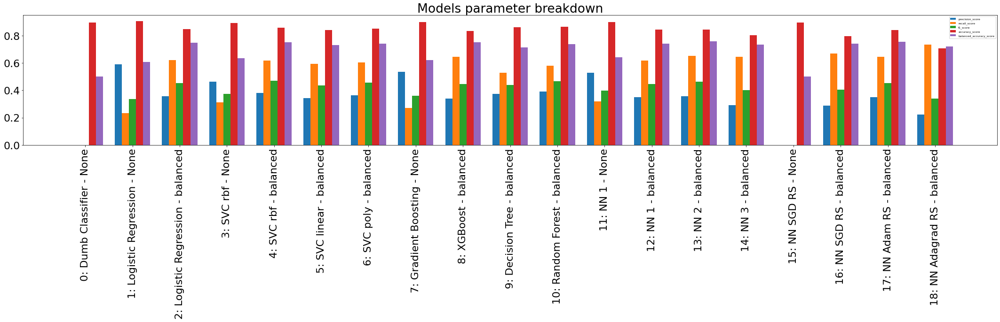

In [101]:
make_bars_2(my_models)

precision_score


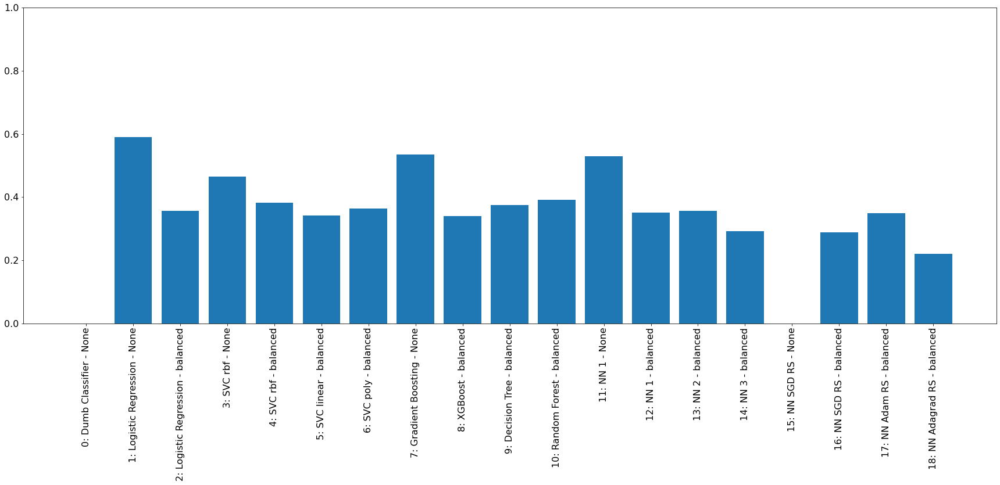

recall_score


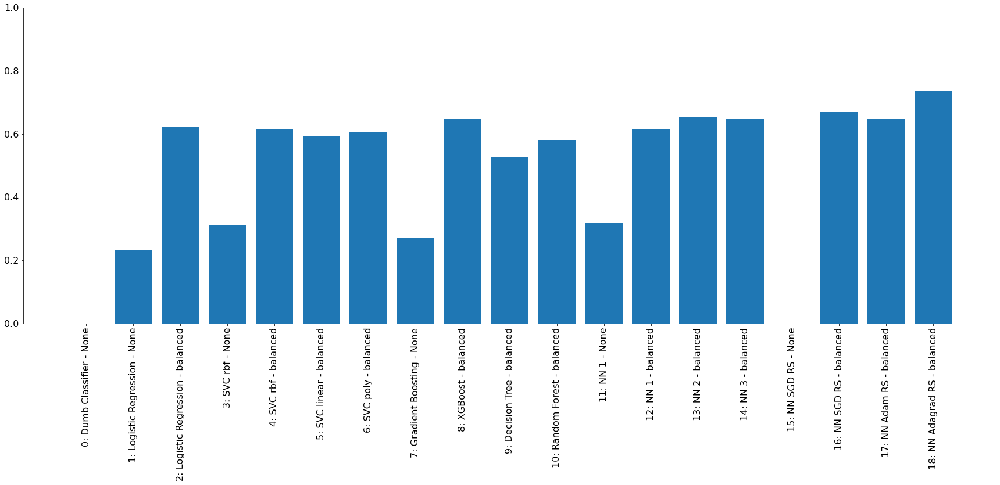

f1_score


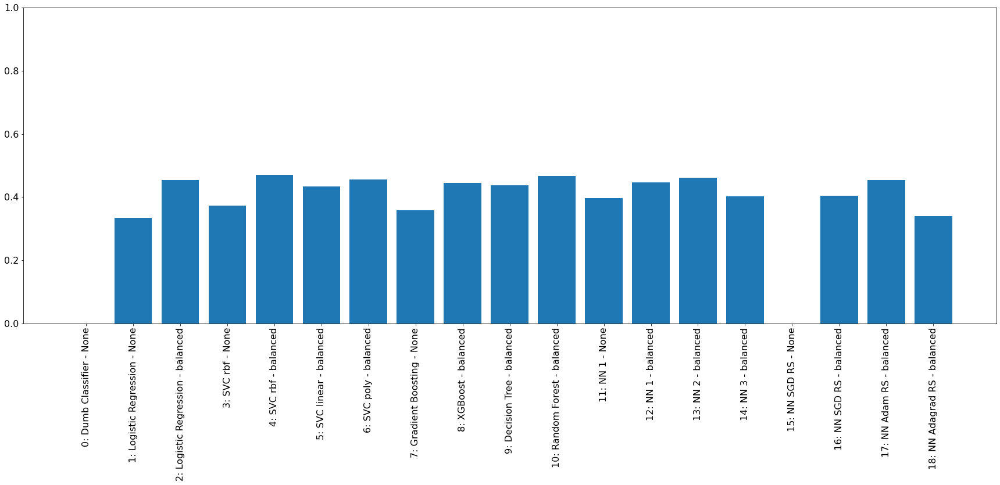

accuracy_score


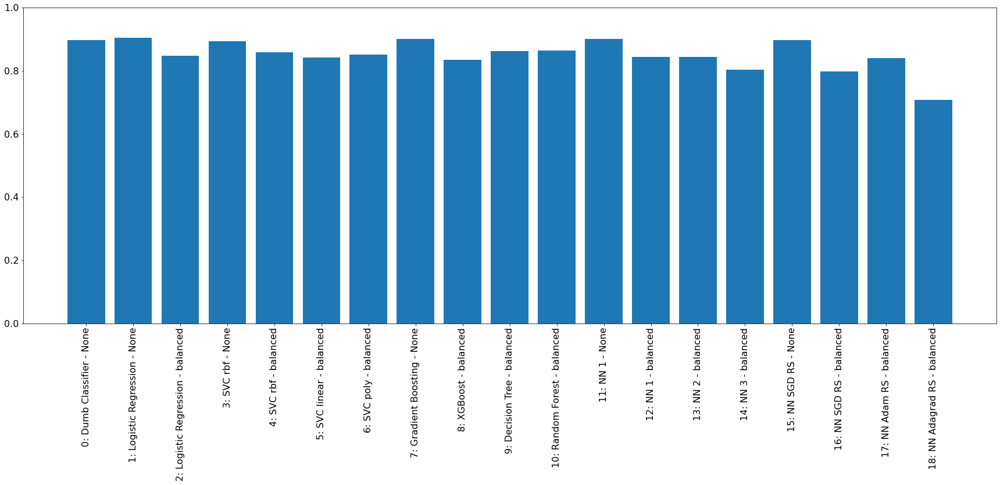

balanced_accuracy_score


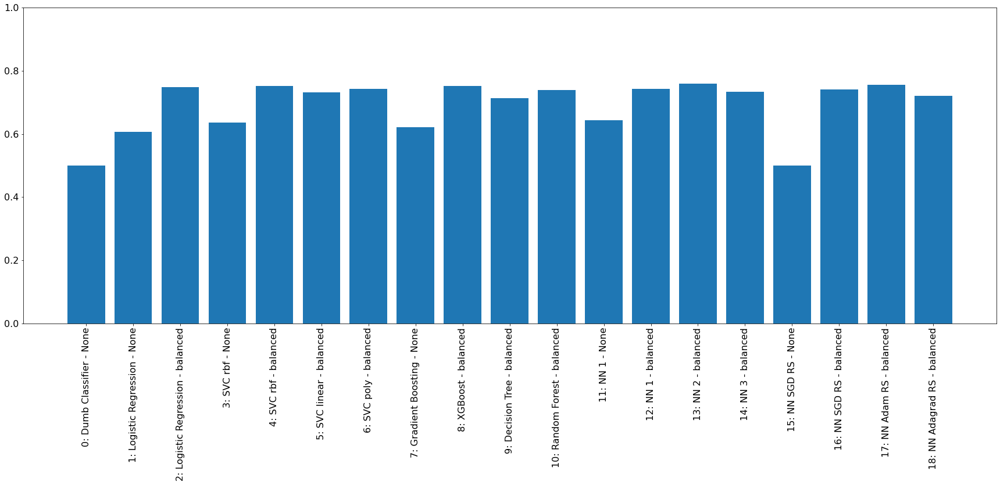

In [99]:
plot_bars(my_models,'precision_score')
plot_bars(my_models,'recall_score')
plot_bars(my_models,'f1_score')
plot_bars(my_models,'accuracy_score')
plot_bars(my_models,'balanced_accuracy_score')

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:    2.3s finished


52/52 [==============================] - 0s 2ms/step


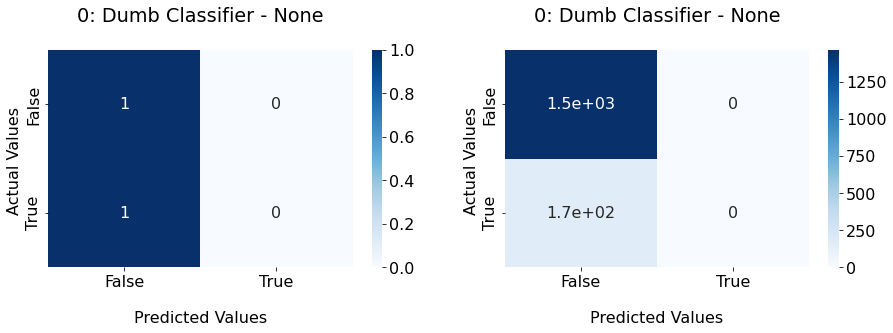

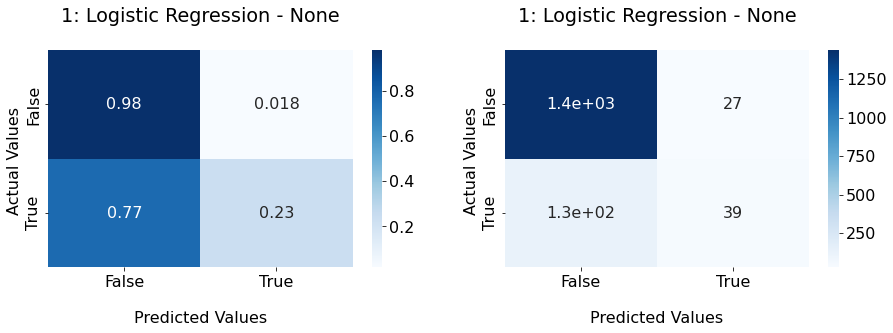

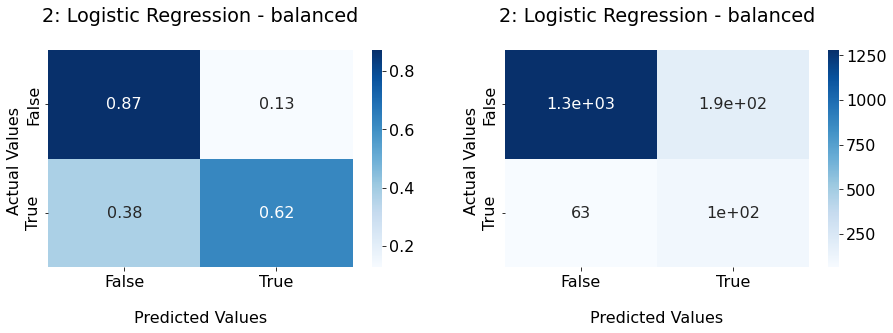

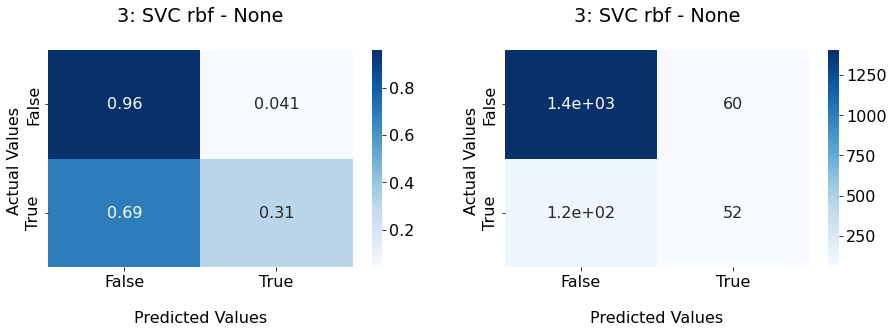

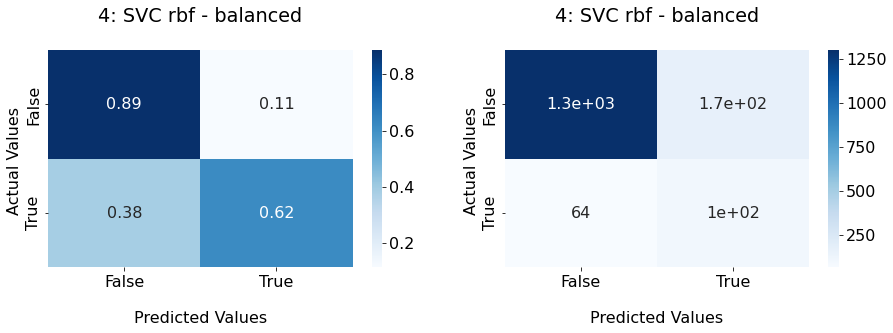

...

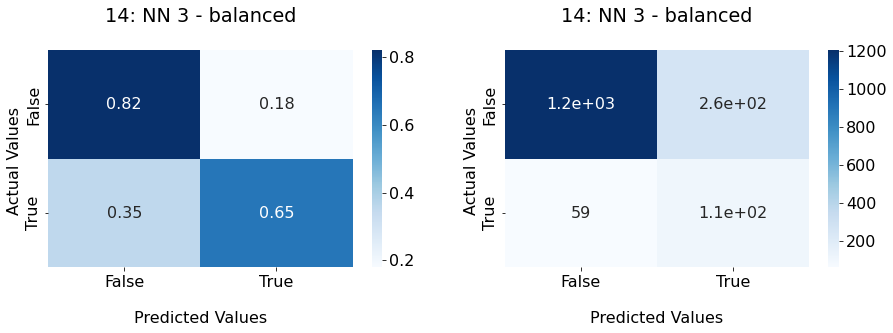

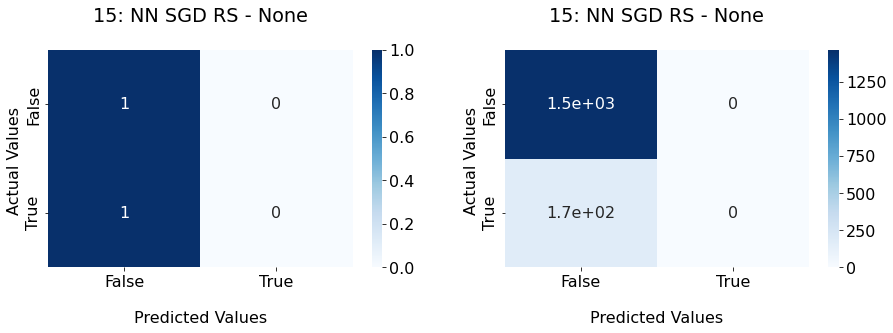

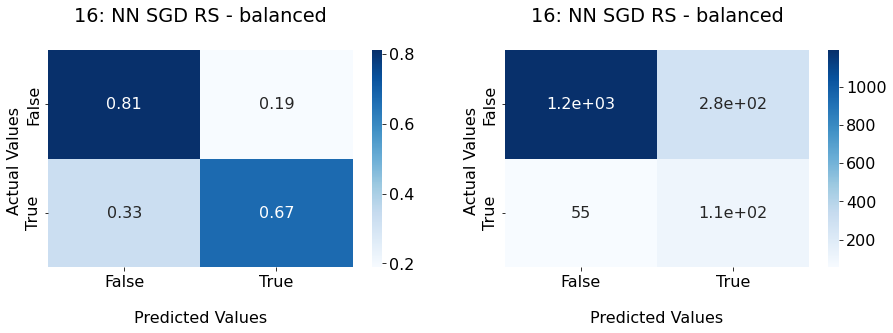

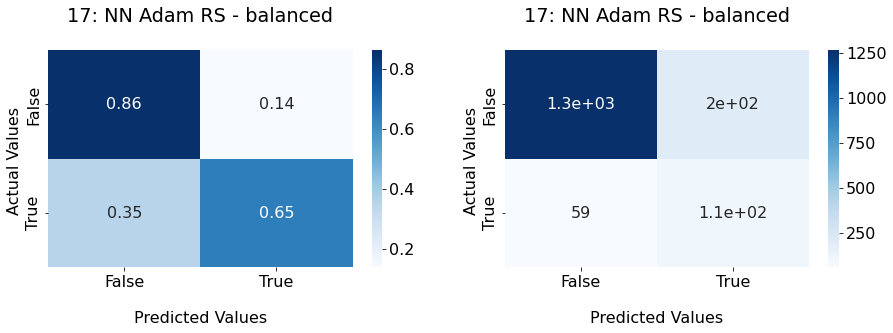

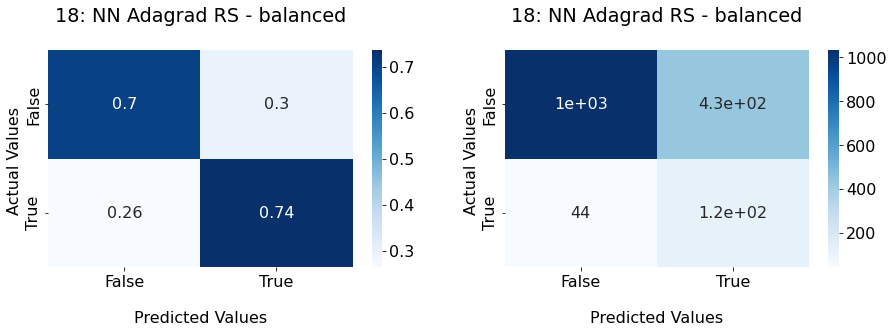

In [96]:
for index, row in my_models.iterrows():
    show_con_mat(row['model_name'], row['model'])

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 500 out of 500 | elapsed:    0.3s finished


52/52 [==============================] - 0s 2ms/step


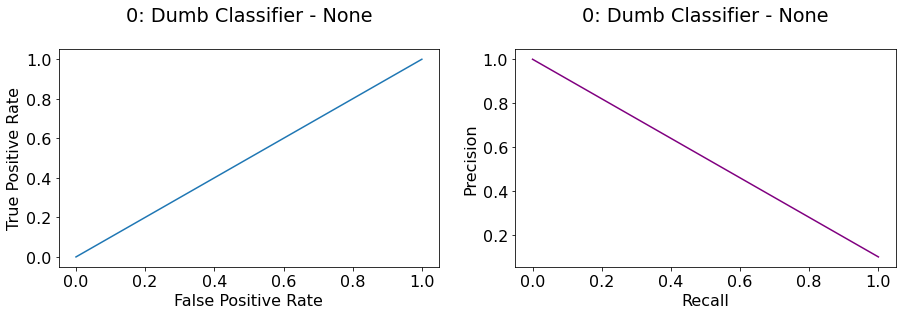

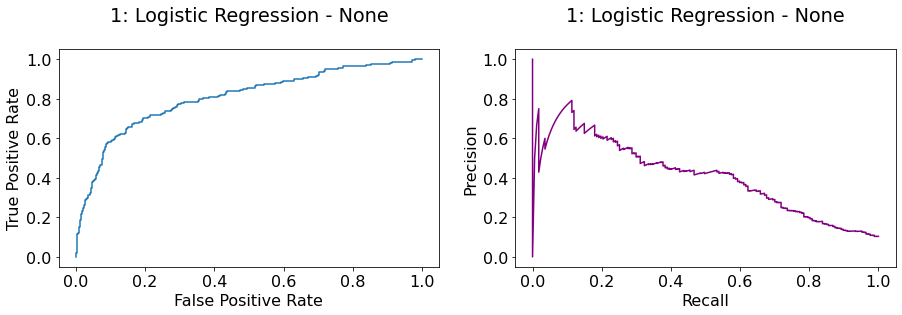

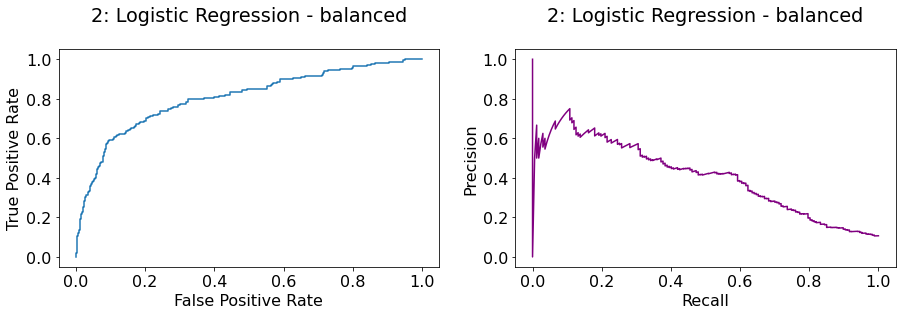

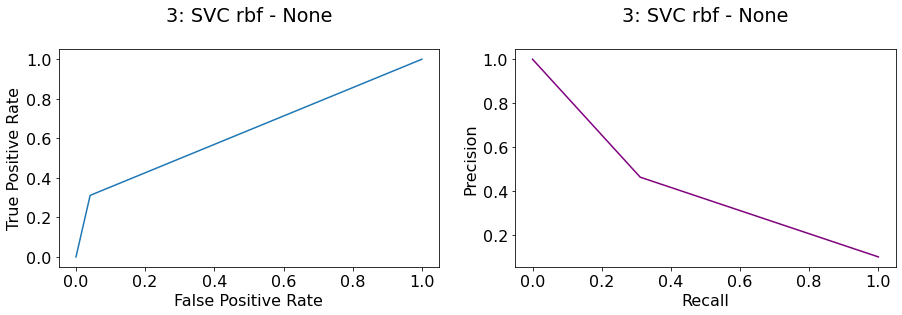

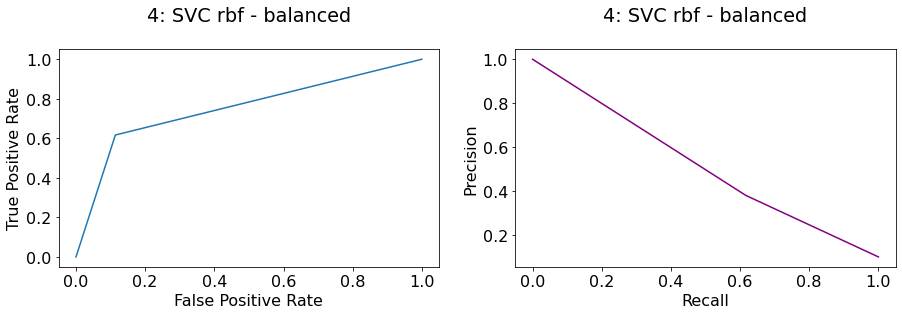

...

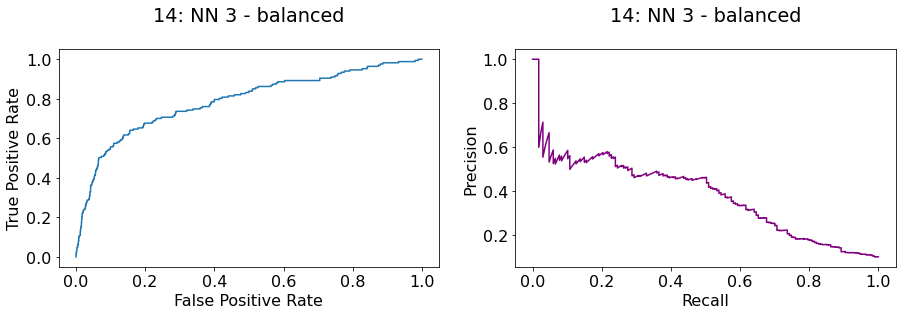

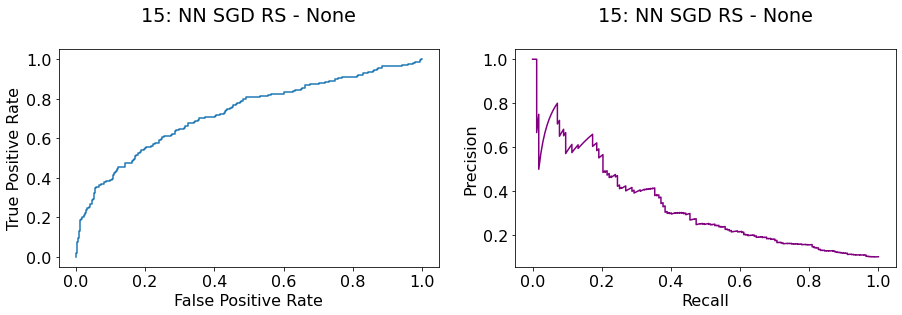

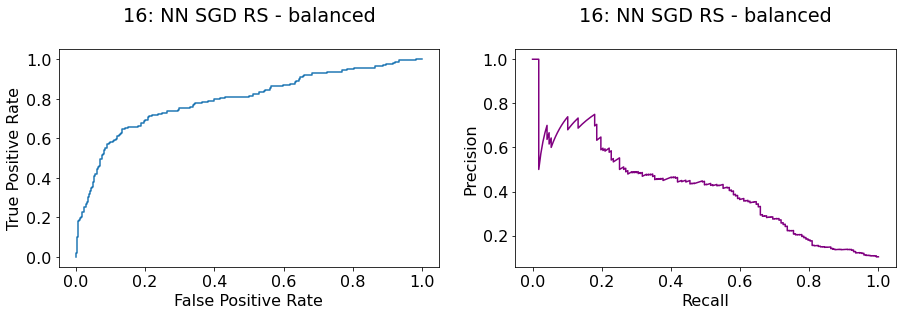

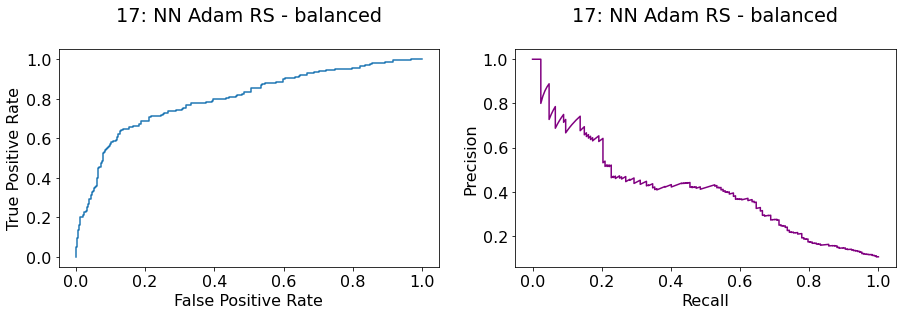

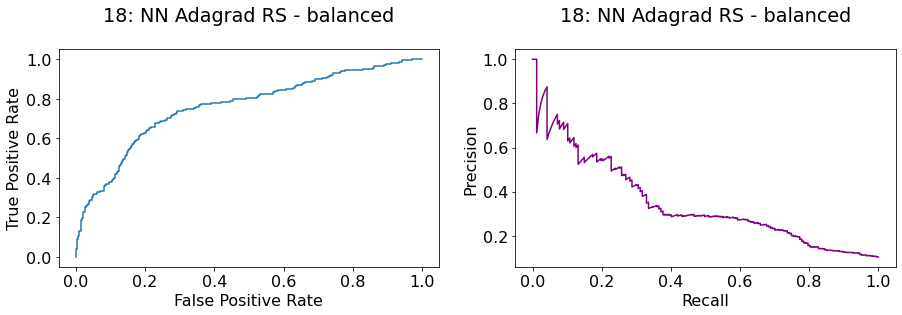

In [115]:
for index, row in my_models.iterrows():
    show_curves(row['model_name'], row['model'], row['proba'])

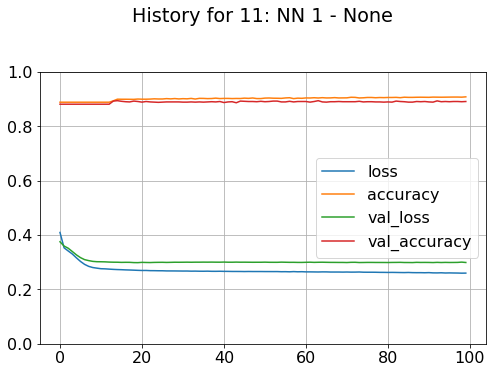

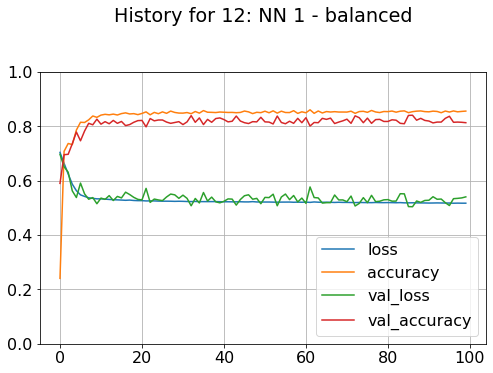

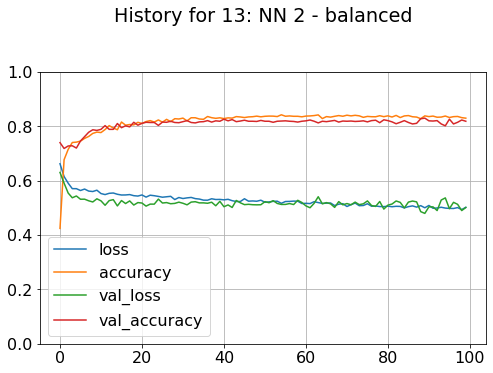

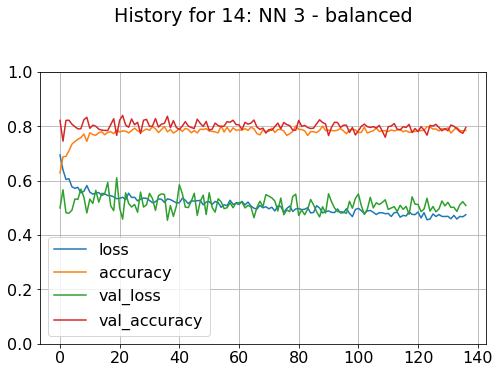

In [104]:
for index, row in my_models.iterrows():
    if row['model_history'] is not None:
        show_history(row['model_name'], row['model_history'])